In [1]:
# Importing modules
import numpy as np
import pandas as pd
import altair as alt
import seaborn as sns

import matplotlib.pyplot as plt
plt.style.use('ggplot')
%matplotlib inline  
plt.rcParams['figure.figsize'] = (10, 6) 

# Reading in data
fire_data = pd.read_csv('fire_data_cleaned.csv')
air_quality_data = pd.read_csv('air_quality_data_cleaned.csv')
all_data = pd.concat([fire_data, air_quality_data])

In [2]:
print(fire_data.shape)
fire_data.head(20)

(902376, 10)


,Unnamed: 0,acq_date,acq_time,latitude,longitude,brightness,frp,daynight,confidence,daynight_num
0,20,2001-01-02,618,33.4115,-110.8618,304.1,45.3,N,59,0
1,21,2001-01-02,619,36.7729,-118.8688,303.0,10.6,N,52,0
2,56,2001-01-02,1820,37.7012,-109.3073,312.8,15.0,D,73,1
3,57,2001-01-02,1821,32.8952,-105.6414,308.3,18.0,D,67,1
4,58,2001-01-02,1821,33.4129,-110.8626,317.3,15.8,D,77,1
5,62,2001-01-03,522,33.0057,-105.6621,310.0,15.8,N,79,0
6,63,2001-01-03,522,33.0145,-105.6639,319.7,23.7,N,99,0
7,64,2001-01-03,522,33.0130,-105.6745,319.2,23.2,N,98,0
8,65,2001-01-03,522,33.0219,-105.6763,321.1,24.9,N,100,0
9,66,2001-01-03,522,33.0307,-105.6781,325.5,30.0,N,100,0


In [3]:
fire_data_corr = fire_data.corr()
fire_data_corr

,Unnamed: 0,acq_time,latitude,longitude,brightness,frp,confidence,daynight_num
Unnamed: 0,1.000000,-0.069736,0.003729,-0.149655,0.057217,0.037800,0.042391,-0.091747
acq_time,-0.069736,1.000000,0.007828,0.009427,0.224508,0.075220,-0.020193,0.970217
latitude,0.003729,0.007828,1.000000,-0.167669,-0.069690,-0.032598,-0.038369,0.000322
longitude,-0.149655,0.009427,-0.167669,1.000000,0.050656,0.019871,0.013816,0.070270
brightness,0.057217,0.224508,-0.069690,0.050656,1.000000,0.664654,0.582958,0.224667
frp,0.037800,0.075220,-0.032598,0.019871,0.664654,1.000000,0.264537,0.071537
confidence,0.042391,-0.020193,-0.038369,0.013816,0.582958,0.264537,1.000000,-0.020182
daynight_num,-0.091747,0.970217,0.000322,0.070270,0.224667,0.071537,-0.020182,1.000000


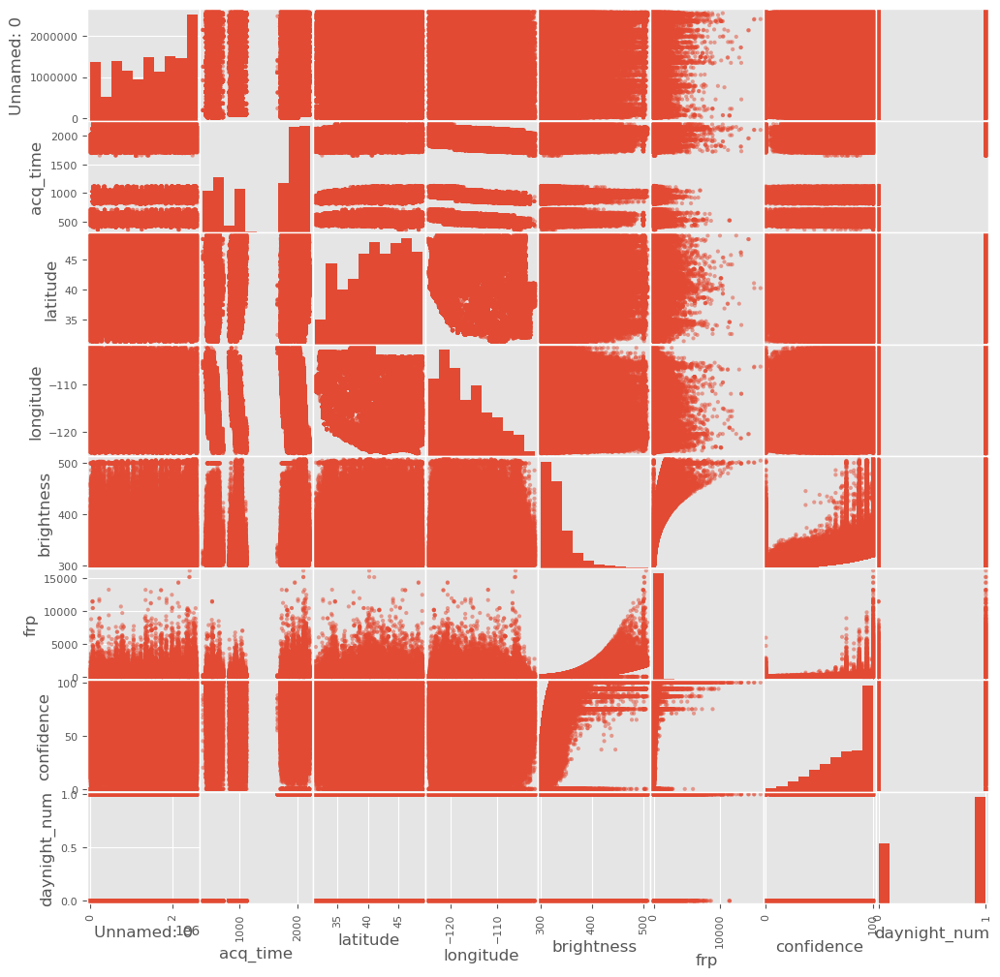

In [4]:
pd.plotting.scatter_matrix(fire_data, figsize=(12,12))
print()

In [5]:
print(air_quality_data.shape)
air_quality_data.head()

(2172855, 8)


,Unnamed: 0,Date,STATE_CODE,SITE_LATITUDE,SITE_LONGITUDE,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE,PERCENT_COMPLETE
0,0,01/13/2001,4,34.058475,-109.441259,0.8,3,100.0
1,1,01/16/2001,4,34.058475,-109.441259,1.7,7,100.0
2,2,02/21/2001,4,34.058475,-109.441259,1.3,5,100.0
3,3,02/24/2001,4,34.058475,-109.441259,1.6,7,100.0
4,4,02/27/2001,4,34.058475,-109.441259,2.1,9,100.0


In [6]:
air_quality_data_corr = air_quality_data.corr()
air_quality_data_corr

,Unnamed: 0,STATE_CODE,SITE_LATITUDE,SITE_LONGITUDE,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE,PERCENT_COMPLETE
Unnamed: 0,1.000000,-0.463233,-0.342457,-0.420715,0.085885,0.105112,NaN
STATE_CODE,-0.463233,1.000000,0.663067,0.090339,-0.139862,-0.174655,NaN
SITE_LATITUDE,-0.342457,0.663067,1.000000,-0.178851,-0.102865,-0.138863,NaN
SITE_LONGITUDE,-0.420715,0.090339,-0.178851,1.000000,-0.119149,-0.148380,NaN
Daily Mean PM2.5 Concentration,0.085885,-0.139862,-0.102865,-0.119149,1.000000,0.930806,NaN
DAILY_AQI_VALUE,0.105112,-0.174655,-0.138863,-0.148380,0.930806,1.000000,NaN
PERCENT_COMPLETE,NaN,NaN,NaN,NaN,NaN,NaN,NaN


C:\Users\Isabelle Cook\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\misc.py:100: UserWarning: Attempting to set identical left == right == 100.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[j])
C:\Users\Isabelle Cook\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\misc.py:101: UserWarning: Attempting to set identical bottom == top == 100.0 results in singular transformations; automatically expanding.
  ax.set_ylim(boundaries_list[i])
C:\Users\Isabelle Cook\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\misc.py:91: UserWarning: Attempting to set identical left == right == 100.0 results in singular transformations; automatically expanding.
  ax.set_xlim(boundaries_list[i])


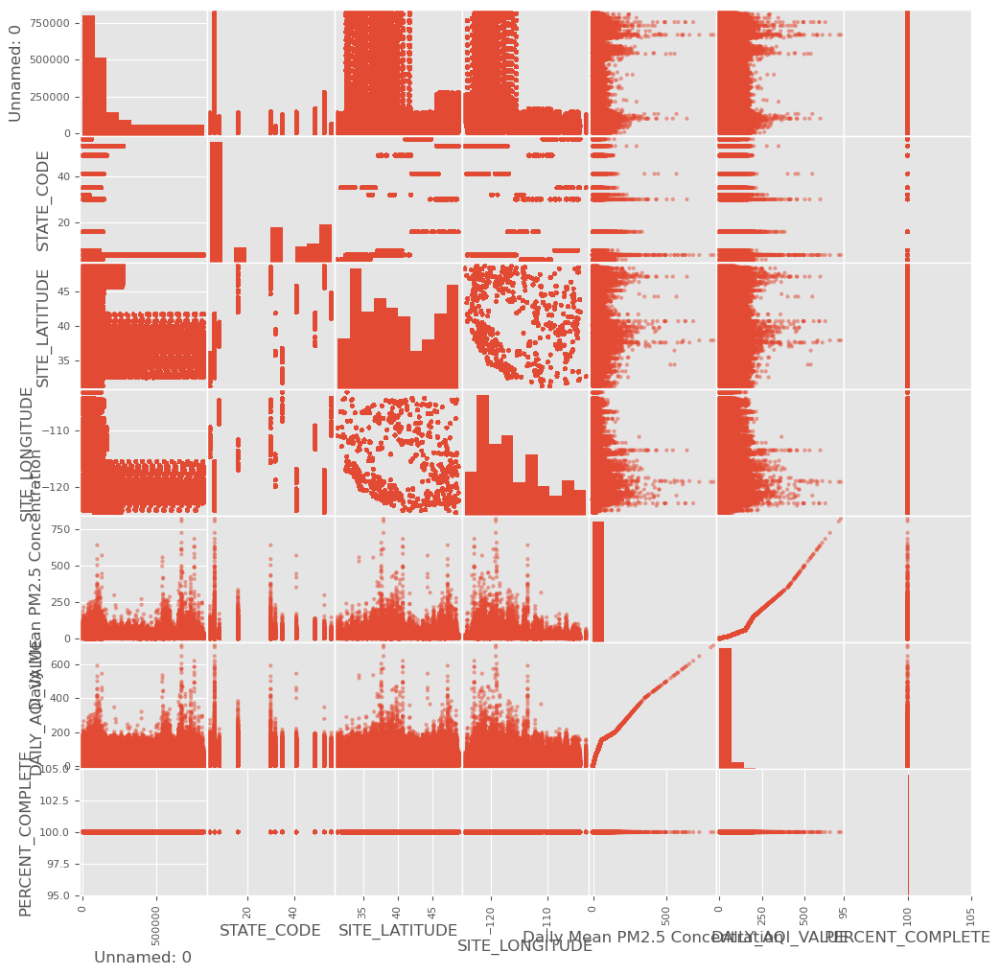

In [7]:
# Scatter matrix of subset of data color coded by property type
pd.plotting.scatter_matrix(air_quality_data, figsize=(12,12))
print()

In [8]:
def fire_year(x):
    x_split = x.split('-')
    return int(x_split[0])

fire_data['acq_year'] = fire_data['acq_date'].apply(fire_year)
fire_data_year_mask = fire_data['acq_year'] == 2020
fire_data_2020 = fire_data.loc[fire_data_year_mask]

def air_quality_year(x):
    x_split = x.split('/')
    return int(x_split[2])
air_quality_data['Year'] = air_quality_data['Date'].apply(air_quality_year)
air_quality_year_mask = air_quality_data['Year'] == 2020
air_quality_2020 = air_quality_data.loc[air_quality_year_mask]


In [9]:
fire_data_2020.head()

,Unnamed: 0,acq_date,acq_time,latitude,longitude,brightness,frp,daynight,confidence,daynight_num,acq_year
718445,2284126,2020-01-01,920,33.4178,-110.8616,321.5,24.9,N,100,0,2020
718446,2284166,2020-01-01,1845,36.4194,-119.8197,305.3,8.6,D,46,1,2020
718447,2284167,2020-01-01,1845,33.8062,-115.3910,312.3,11.5,D,72,1,2020
718448,2284168,2020-01-01,1845,33.8041,-115.3785,311.1,10.5,D,71,1,2020
718449,2284169,2020-01-01,1845,33.8020,-115.3660,306.7,6.6,D,36,1,2020


In [10]:
air_quality_2020.head()

,Unnamed: 0,Date,STATE_CODE,SITE_LATITUDE,SITE_LONGITUDE,Daily Mean PM2.5 Concentration,DAILY_AQI_VALUE,PERCENT_COMPLETE,Year
107470,107470,01/04/2020,4,35.880404,-109.438003,0.8,3,100.0,2020
107471,107471,01/10/2020,4,35.880404,-109.438003,1.1,5,100.0,2020
107472,107472,01/16/2020,4,35.880404,-109.438003,0.7,3,100.0,2020
107473,107473,01/22/2020,4,35.880404,-109.438003,0.9,4,100.0,2020
107474,107474,01/28/2020,4,35.880404,-109.438003,0.8,3,100.0,2020


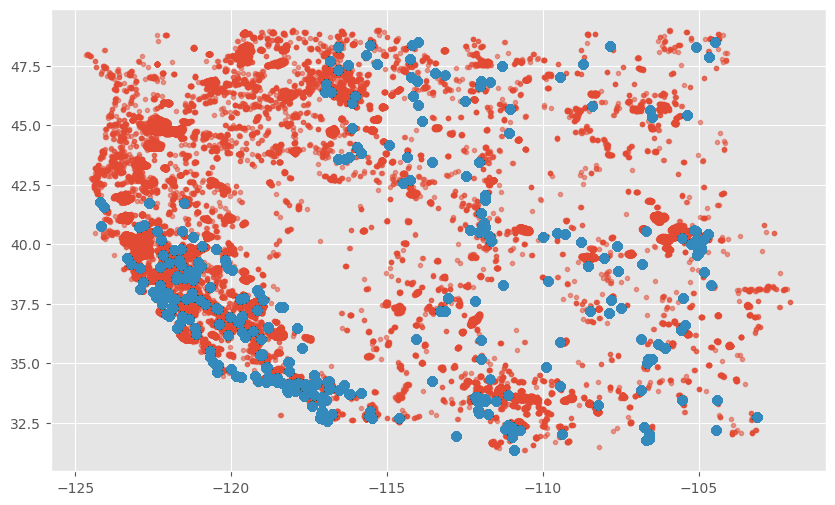

In [17]:
plt.plot(fire_data_2020.longitude, fire_data_2020.latitude, '.', alpha = 0.5, zorder = 1)
plt.plot(air_quality_2020.SITE_LONGITUDE, air_quality_2020.SITE_LATITUDE, 'o', alpha = 0.5, zorder = 2)
plt.show()

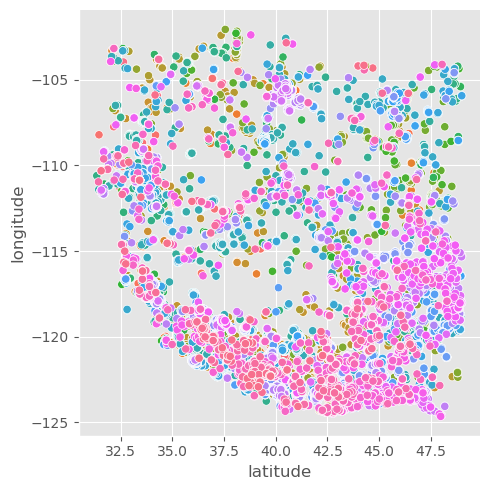

In [12]:
sns.relplot(
    data = fire_data_2020,
    x = 'latitude', y = 'longitude', hue = 'acq_date',
    legend = False
    )

In [18]:
def fire_date_to_number(x):
    x_split = x.split('-')
    x_split = [x_split[1], x_split[2], x_split[0]]
    return int(''.join(x_split))
fire_data_2020['acq_date_num'] = fire_data_2020['acq_date'].apply(fire_date_to_number)

C:\conda_temp\ipykernel_9272\1698610848.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  fire_data_2020['acq_date_num'] = fire_data_2020['acq_date'].apply(fire_date_to_number)


In [19]:
alt.data_transformers.disable_max_rows()
alt.Chart(fire_data_2020).mark_circle().encode(
  alt.X('latitude', scale = alt.Scale(zero = False)),
  alt.Y('longitude', scale = alt.Scale(zero = False)),
  color = 'acq_date_num'
).properties(width = 900, height = 700)

alt.Chart(...)